## install visionlens

In [1]:
!rm -rf /kaggle/working/*
!git clone https://github.com/SKT27182/VisionLens.git
!mv  /kaggle/working/VisionLens/* .

Cloning into 'VisionLens'...
remote: Enumerating objects: 230, done.
remote: Counting objects: 100% (230/230), done.
remote: Compressing objects: 100% (160/160), done.
remote: Total 230 (delta 116), reused 176 (delta 65), pack-reused 0 (from 0)
Receiving objects: 100% (230/230), 14.48 MiB | 14.95 MiB/s, done.
Resolving deltas: 100% (116/116), done.


In [2]:
!pip3 install einops==0.8.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 1.4 MB/s eta 0:00:00


## imports

In [1]:
import torch
from torchvision.transforms import transforms
import numpy as np
from copy import deepcopy
from PIL import Image


from typing import Union

import einops
from matplotlib import pyplot as plt

from visionlens.models import InceptionV1
from visionlens.objectives import objective_wrapper
from visionlens.optimize import Visualizer
from visionlens import objectives
from visionlens.images import get_images
from visionlens.utils import device

In [2]:
model = InceptionV1(pretrained=True).eval()

## Style Transfer

In [3]:
def load_deepdream_img(file_path: str, img_size: tuple = (224, 224)) -> torch.Tensor:
    img = Image.open(file_path)
    img = img.resize(img_size)
    img = np.array(img)
    img = torch.tensor(img, dtype=torch.float32)
    img = img/255.0
    img = einops.rearrange(img, 'h w c -> 1 c h w')
    img = img.to(device)
    return img

In [4]:
from visionlens.images import STANDARD_TRANSFORMS, to_valid_rgb


layers = [
    # "mixed3a",
    # "mixed3b",
    "mixed4a",
    # "mixed4b",
    # "mixed4c",
    "mixed4d",
    "mixed4e",
    "mixed5a",
    "mixed5b",
]

orig_h = 512
orig_w = 720
image = load_deepdream_img("images/under_the_sea.jpg", img_size=(orig_h, orig_w))

def get_deepdream_image():

    param = image
    param.requires_grad = True

    return [param], to_valid_rgb(lambda : param, decorrelate=False)


octave_scale = 1.3
octaves = [-2, -1, 0, 1, 2]
octave_images = []
all_images = []


# @objective_wrapper
def mean_loss_obj(hooks):

    return -sum([hooks(layer).mean() for layer in layers]) / len(layers)

2024-11-30 13:56:35 - 4834 - visionlens.img_utils.display_images_in_table:130 - INFO - Displaying 1 images in a table.


torch.Size([3, 720, 512])


""

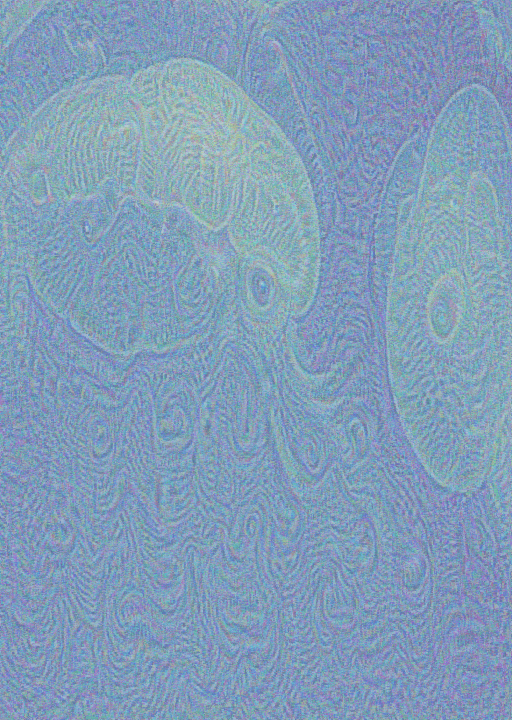

2024-11-30 13:56:35 - 4834 - visionlens.optimize.visualize:182 - INFO - Epoch 10/201 - Loss: -39.26
2024-11-30 13:56:35 - 4834 - visionlens.optimize._single_forward_loop:94 - INFO - Loss: -39.52


In [ ]:
for octave in octaves:

    new_size_h = int(orig_h * octave_scale**octave)
    new_size_w = int(orig_w * octave_scale**octave)
    print(f"New Size: {(new_size_h, new_size_w)}")

    extra_t = STANDARD_TRANSFORMS.copy() + [
        lambda x: transforms.Resize((new_size_h, new_size_w))(x),
    ]

    viz = Visualizer(model, mean_loss_obj, transforms=extra_t)
    images = viz.visualize(
        get_deepdream_image,
        threshold=range(0, 201,  20),
        lr=0.07,
    )
    octave_images.append(images[-1])
    all_images.extend(images)

In [26]:
from torchvision.transforms.functional import to_pil_image

In [27]:
image[0].shape

torch.Size([3, 1203, 1604])

In [28]:
image[0].shape

torch.Size([3, 1203, 1604])

In [29]:
image[0].min(), image[0].max(), image[0].mean()

(tensor(0., grad_fn=<MinBackward1>),
 tensor(1., grad_fn=<MaxBackward1>),
 tensor(0.5175, grad_fn=<MeanBackward0>))

In [34]:
get_deepdream_image()[1]().shape

torch.Size([1, 3, 1203, 1604])

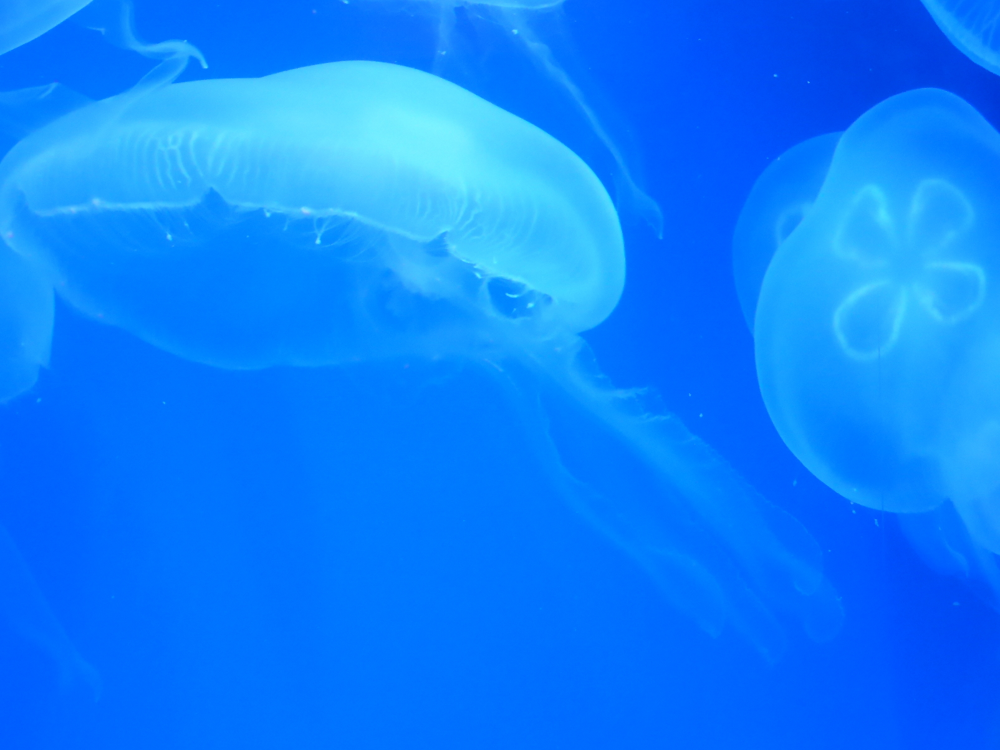

In [37]:
to_pil_image(image[0])

In [39]:
image[0].shape

torch.Size([3, 1203, 1604])

In [40]:
get_deepdream_image()[1]()[0].shape

torch.Size([3, 1203, 1604])

In [38]:
image[0] == get_deepdream_image()[1]()[0]

tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [

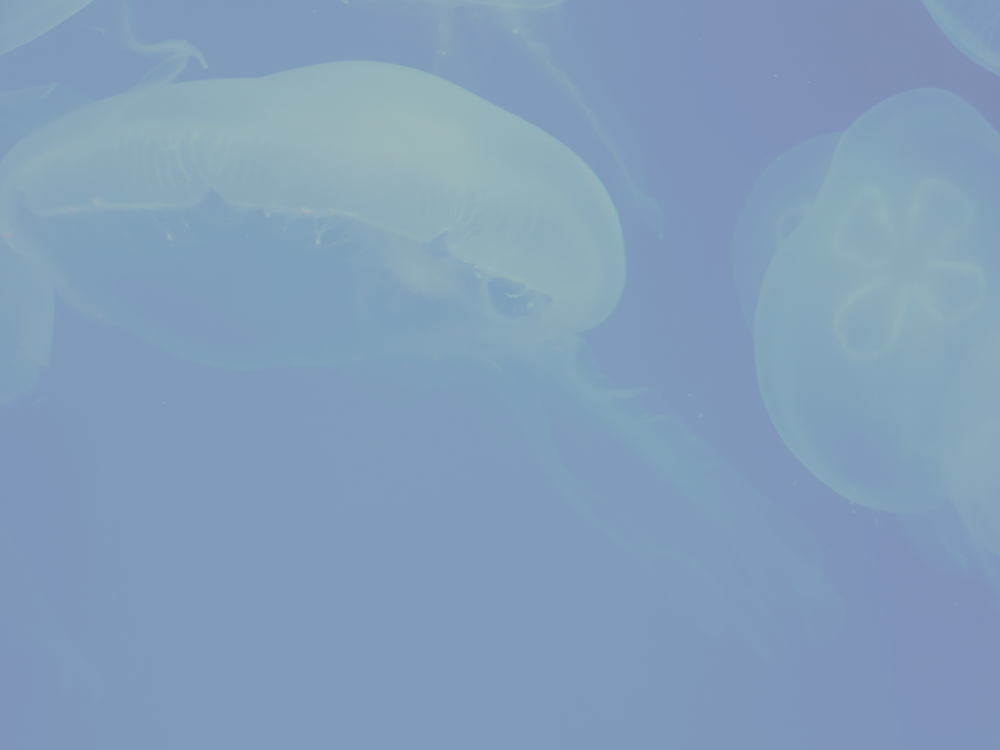

In [35]:
to_pil_image(get_deepdream_image()[1]()[0])

2024-11-30 13:43:38 - 3561 - visionlens.img_utils.display_images_in_table:130 - INFO - Displaying 1 images in a table.


torch.Size([3, 1203, 1604])


""

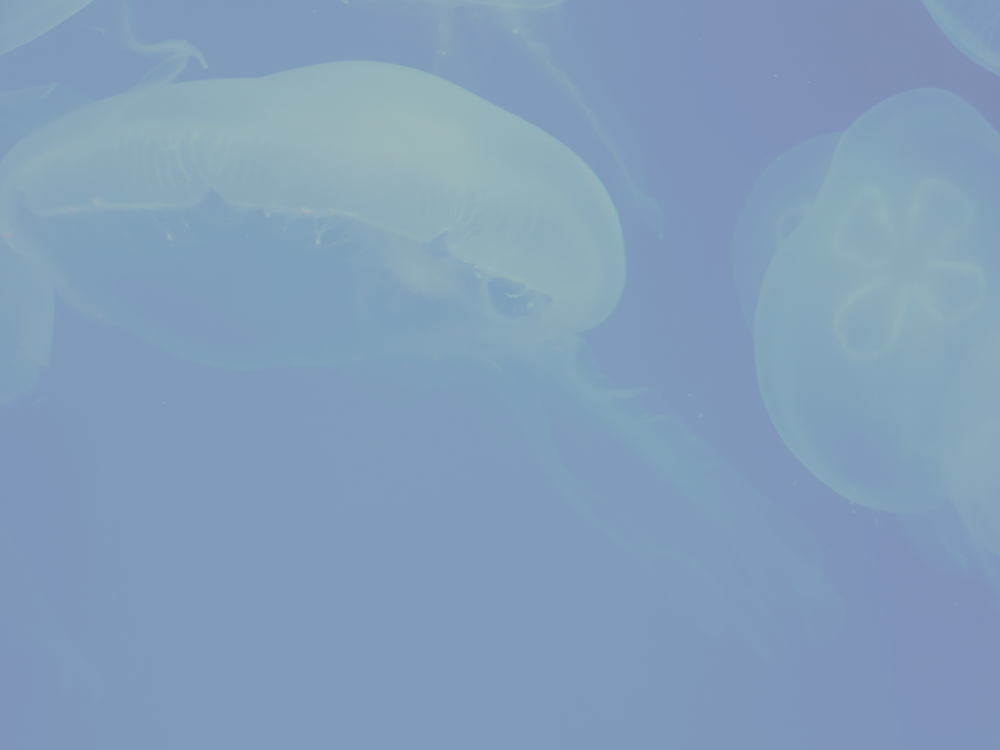

In [36]:
from visionlens.img_utils import display_images_in_table


display_images_in_table(get_deepdream_image()[1]())

In [ ]:
class DeepDream:

    def __init__(self, model, content_image: Union[str, torch.Tensor], style_image: Union[str, torch.Tensor]):
        self.model = model
        self.content_image = content_image if isinstance(content_image, torch.Tensor) else self.load_image(content_image)
        self.style_image = style_image if isinstance(style_image, torch.Tensor) else self.load_image(style_image)

        self.TRANSFER_INDEX = 0
        self.CONTENT_INDEX = 1
        self.STYLE_INDEX = 2

    def load_image(self, file_path: str) -> torch.Tensor:
        """
        Convert an image to a tensor.

        Args:
            file_path: Path to the image file.

        Returns:
            Tensor representation of the image of shape (H, W, C).
        """
        img = plt.imread(file_path)
        img = torch.tensor(img, dtype=torch.float32)
        return img

    def get_style_transfer_params(self, content_image, style_image, decorrelate=True, fft=True):
        """
        Generates parameters and a function for style transfer.

        Args:
            content_image (numpy.ndarray): The content image to be used for style transfer.
            style_image (numpy.ndarray): The style image to be used for style transfer.
            decorrelate (bool, optional): Whether to decorrelate the images. Defaults to True.
            fft (bool, optional): Whether to use FFT for image processing. Defaults to True.

        Returns:
            tuple: A tuple containing:
                - params: Parameters for the style transfer.
                - inner (function): A function that returns a tensor stack of style transfer input, content input, and style input.
        """

        content_h, content_w = content_image.shape[:2]  # assume we use content_image.shape
        params, image = get_images(content_h, content_w, decorrelate=decorrelate, fft=fft)

        def inner():
            style_transfer_input = image()[0]

            content_input = (
                torch.tensor(einops.rearrange(content_image, "h w c -> c h w").float().to(device))
            )
            style_input = (
                torch.tensor(
                    einops.rearrange(
                        style_image[:content_h, :content_w, :], "h w c -> c h w"
                    )
                )
                .float()
                .to(device)
            )
            return torch.stack([style_transfer_input, content_input, style_input])

        return params, inner

    @staticmethod
    def gram_matrix(features, normalize=True):
        C, H, W = features.shape
        # Flatten the features to compute the gram matrix
        features = einops.rearrange(features, "c h w -> c (h w)")
        # Compute the gram matrix, which is of shape (C, C)
        gram = torch.einsum("cl, dl -> cd", features, features)

        if normalize:
            gram = gram / (H * W)
        return gram

    @staticmethod
    def mean_L1_loss(x, y):
        """
            Compute the mean L1 loss between two tensors.

            Args:
                x (torch.Tensor): The first tensor.
                y (torch.Tensor): The second tensor.

            Returns:
                torch.Tensor: The mean L1 loss.
            """
        return torch.mean(torch.abs(x - y))

    @objective_wrapper
    def get_activations_difference(
        self,
        layer_names,
        difference_to,
        loss_type=None,
        obj_name="activation_difference",
        transform_f=None,
    ):

        obj_name = f"{obj_name}_activations_difference"

        loss_type = StyleTransfer.mean_L1_loss if loss_type is None else loss_type

        def get_activation_loss(act_dict):

            image_activations = [
                act_dict(layer_name)[difference_to] for layer_name in layer_names
            ]

            if transform_f is not None:
                image_activations = [transform_f(act) for act in image_activations]

            optimization_activations = [
                act_dict(layer_name)[self.TRANSFER_INDEX] for layer_name in layer_names
            ]

            if transform_f is not None:
                optimization_activations = [transform_f(act) for act in optimization_activations]

            losses = [loss_type(optimization_act, image_act) for optimization_act, image_act in zip(optimization_activations, image_activations)]

            return torch.stack(losses).sum()

        return get_activation_loss, obj_name

    def style_transfer(
        self,
        style_layers,
        content_layers,
        content_weight=200,
        style_weight=1,
        decorrelate=True,
        fft=True,
        threshold=(5, 50, 512), 
        ** kwargs,
    ):
        STYLE_LAYERS = style_layers
        CONTENT_LAYERS = content_layers

        param_f = lambda: self.get_style_transfer_params(self.content_image, self.style_image, decorrelate=decorrelate, fft=fft)

        content_obj = self.get_activations_difference(CONTENT_LAYERS, difference_to=self.CONTENT_INDEX, obj_name="content_loss")

        style_obj = self.get_activations_difference(
            STYLE_LAYERS, transform_f=self.gram_matrix, difference_to=self.STYLE_INDEX, obj_name="style_loss"
        )

        objective = content_weight * content_obj + style_weight * style_obj

        viz = Visualizer(self.model, objective)
        images = viz.visualize(param_f, lr=0.1, threshold=threshold, **kwargs)

        return images

2024-10-31 17:23:01 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

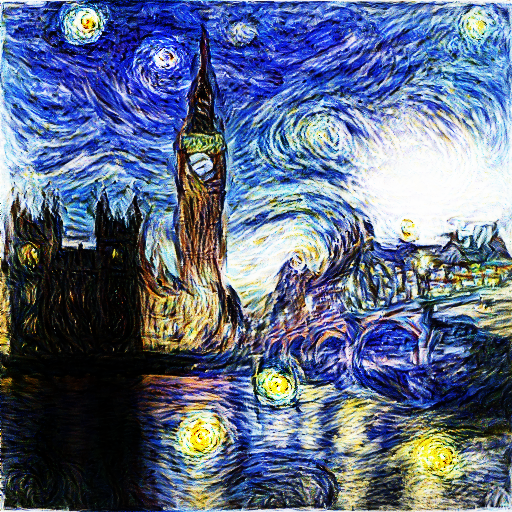
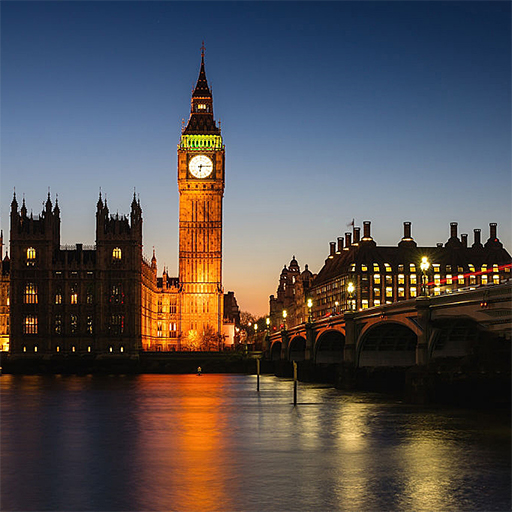
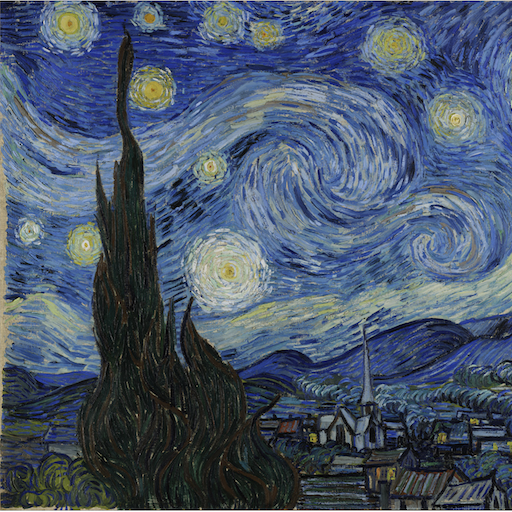

2024-10-31 17:23:01 - 30 - visionlens.optimize.visualize:180 - INFO - Epoch 510/513 - Loss: 14189.43
2024-10-31 17:23:01 - 30 - visionlens.optimize._single_forward_loop:94 - INFO - Loss: 14887.61
2024-10-31 17:23:01 - 30 - visionlens.optimize._single_forward_loop:94 - INFO - Loss: 14654.58
2024-10-31 17:23:01 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

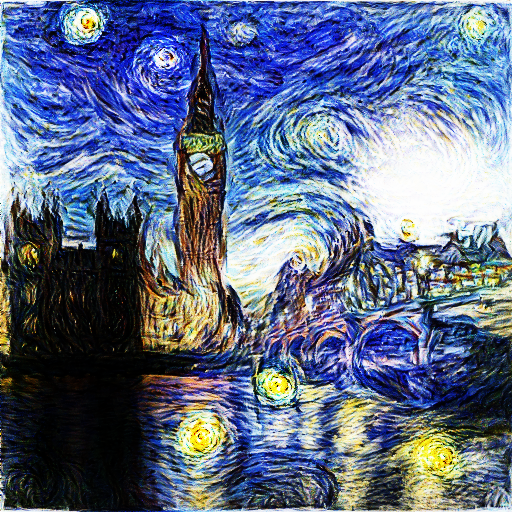
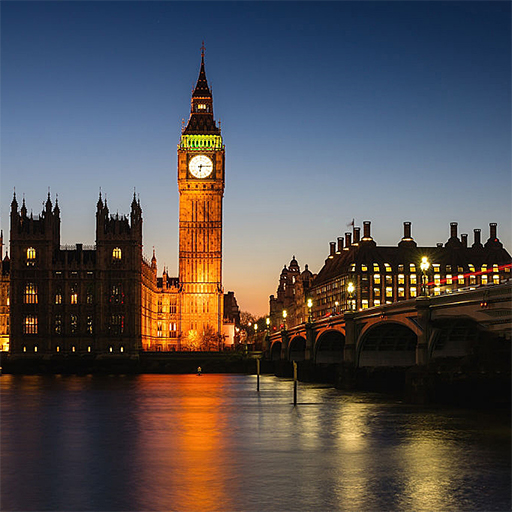
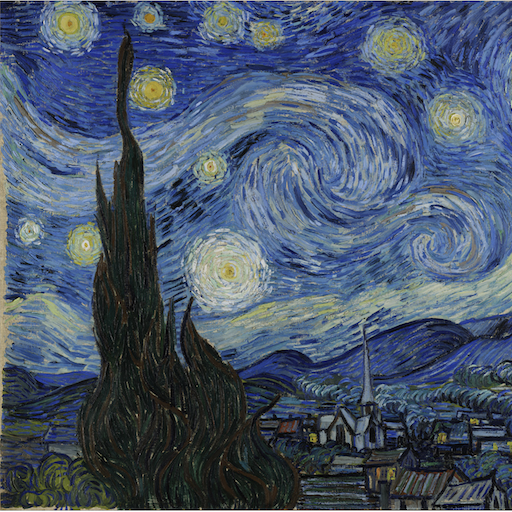

In [9]:
STYLE_LAYERS = [
    "conv2d2",
    "mixed3a",
    "mixed4a",
    "mixed4b",
    "mixed4c",
]

CONTENT_LAYERS = [
    "mixed3b",
]


content_image_pth = "images/transfer_big_ben.png"
style_image_pth = "images/transfer_vangogh.png"

style_transfer = StyleTransfer(
    model, content_image=content_image_pth, style_image=style_image_pth
)
images = style_transfer.style_transfer(
    STYLE_LAYERS, CONTENT_LAYERS, content_weight=200, style_weight=1
)

In [11]:
from visionlens.img_utils import display_images_in_table

2024-10-31 17:23:58 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

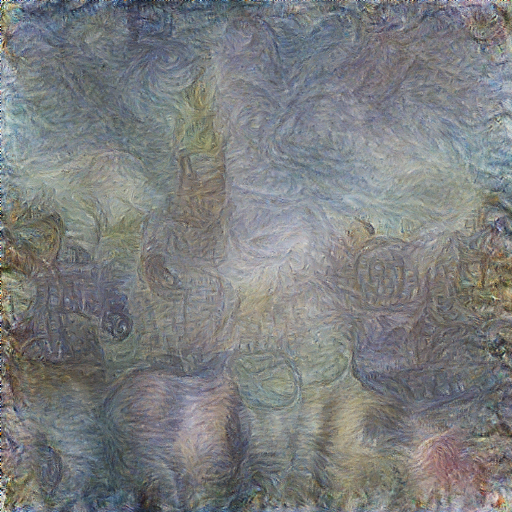
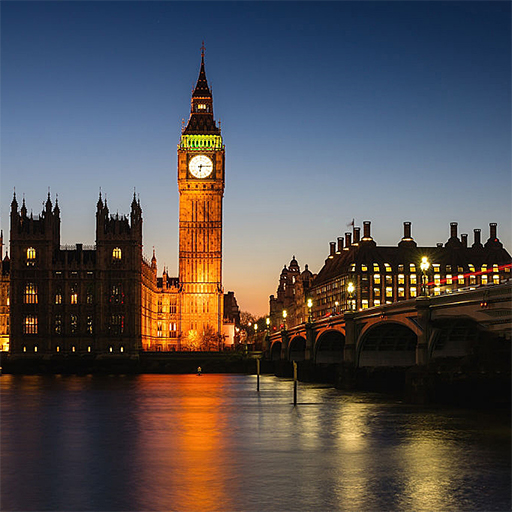
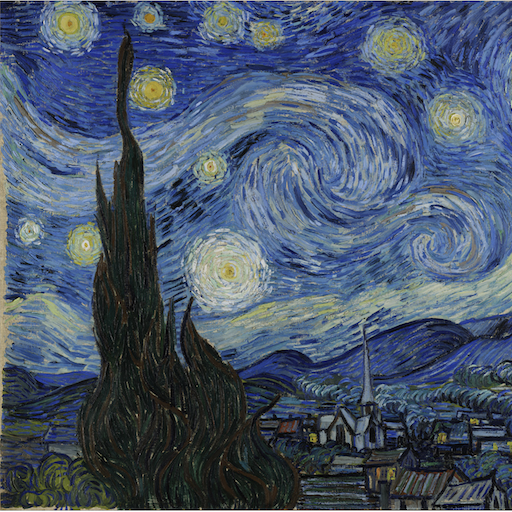

2024-10-31 17:23:58 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

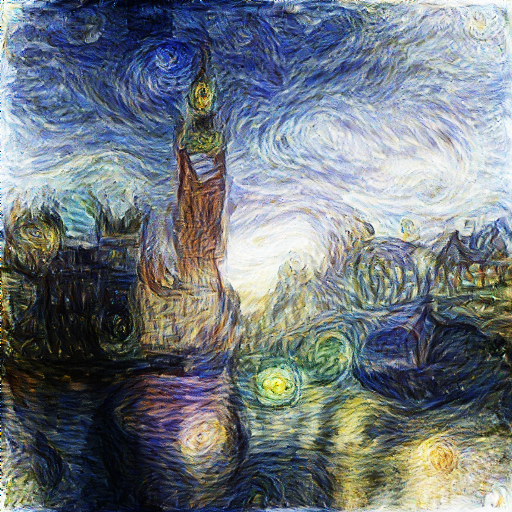
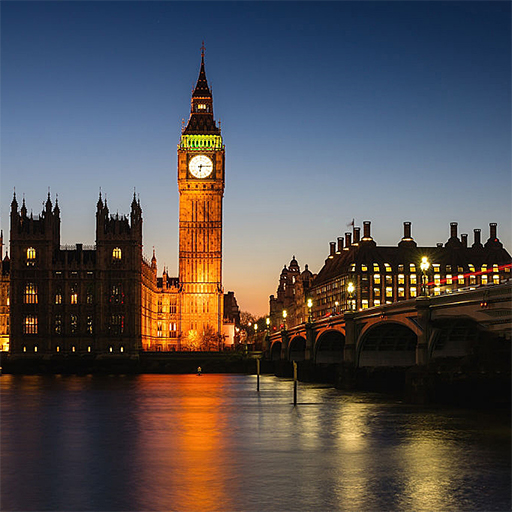
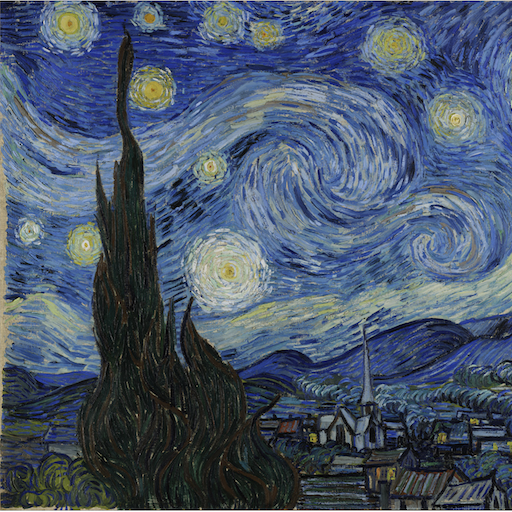

2024-10-31 17:23:58 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

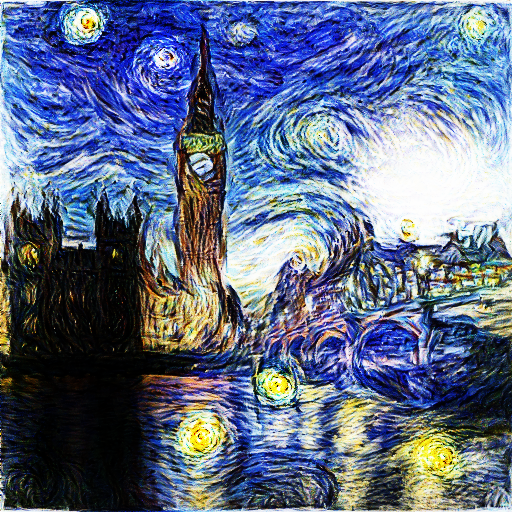
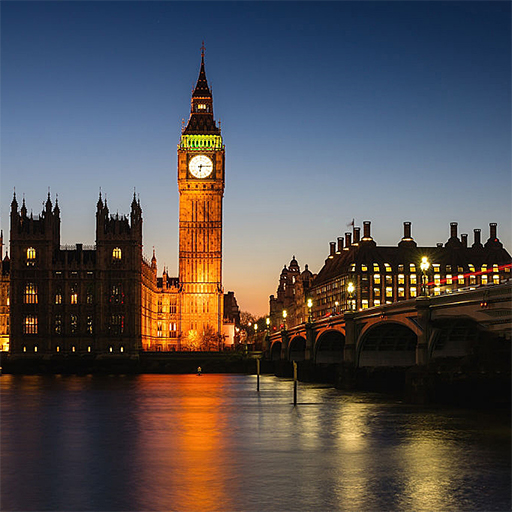
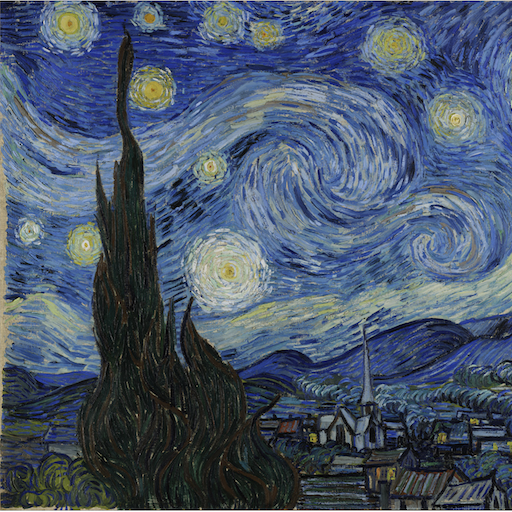

In [12]:
display_images_in_table(images[0])
display_images_in_table(images[1])
display_images_in_table(images[2])

2024-10-31 17:25:13 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

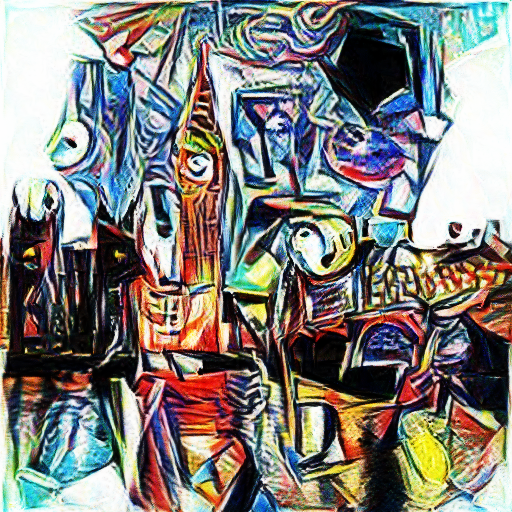
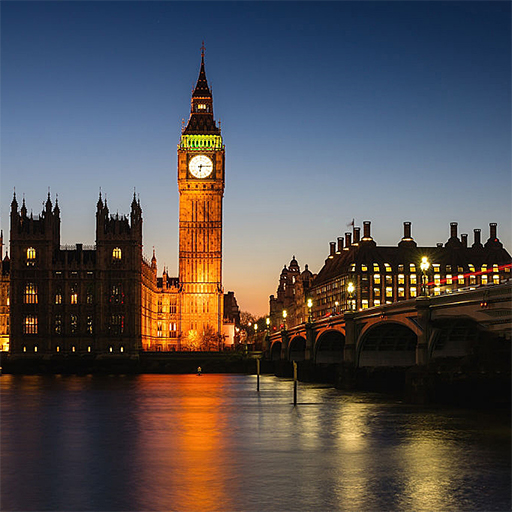
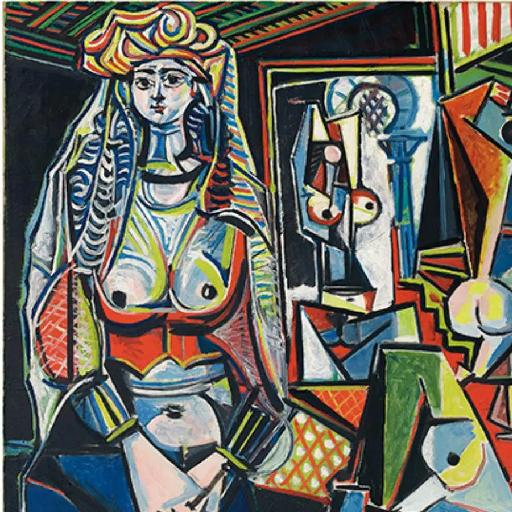

2024-10-31 17:25:13 - 30 - visionlens.optimize.visualize:180 - INFO - Epoch 510/513 - Loss: 16547.26
2024-10-31 17:25:13 - 30 - visionlens.optimize._single_forward_loop:94 - INFO - Loss: 18356.34
2024-10-31 17:25:13 - 30 - visionlens.optimize._single_forward_loop:94 - INFO - Loss: 18275.58
2024-10-31 17:25:14 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

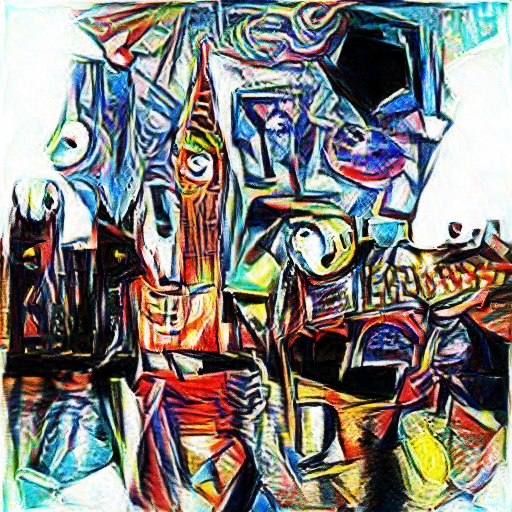
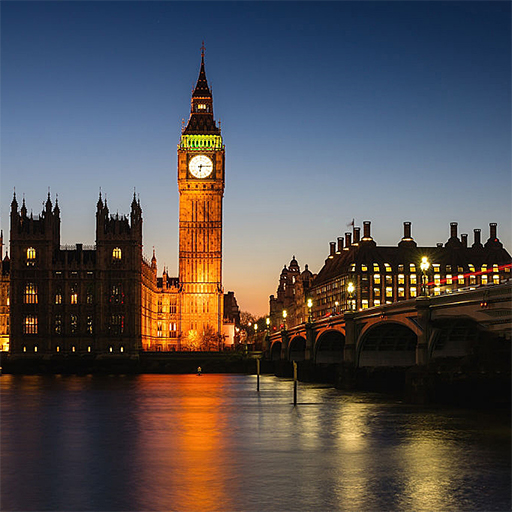
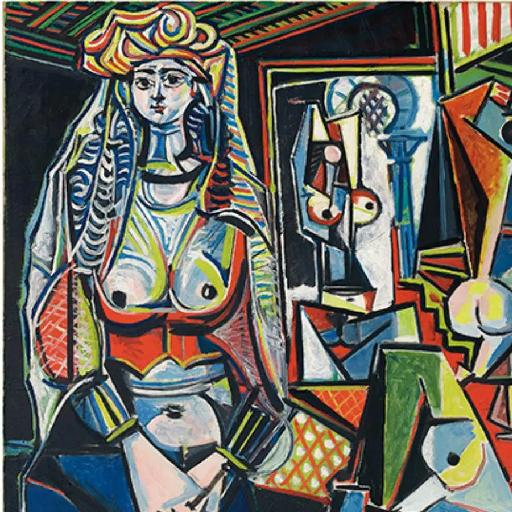

In [13]:
STYLE_LAYERS = [
    "conv2d2",
    "mixed3a",
    "mixed4a",
    "mixed4b",
    "mixed4c",
]

CONTENT_LAYERS = [
    "mixed3b",
]


content_image_pth = "images/transfer_big_ben.png"
style_image_pth = "images/transfer_picasso.png"

style_transfer = StyleTransfer(
    model, content_image=content_image_pth, style_image=style_image_pth
)
images = style_transfer.style_transfer(
    STYLE_LAYERS, CONTENT_LAYERS, content_weight=200, style_weight=1
)

2024-10-31 17:26:03 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

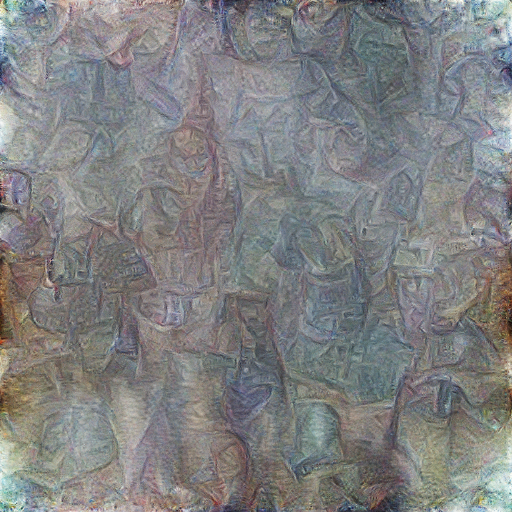
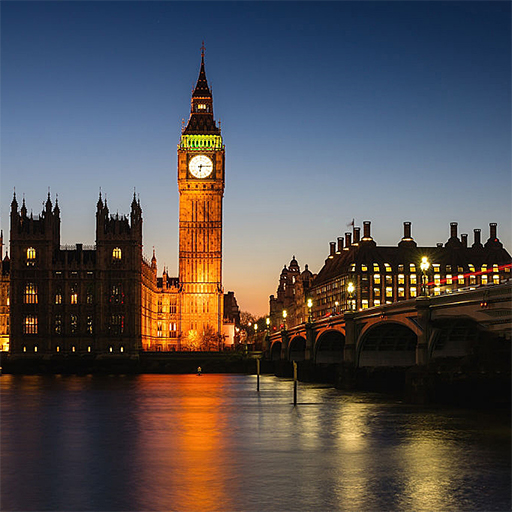
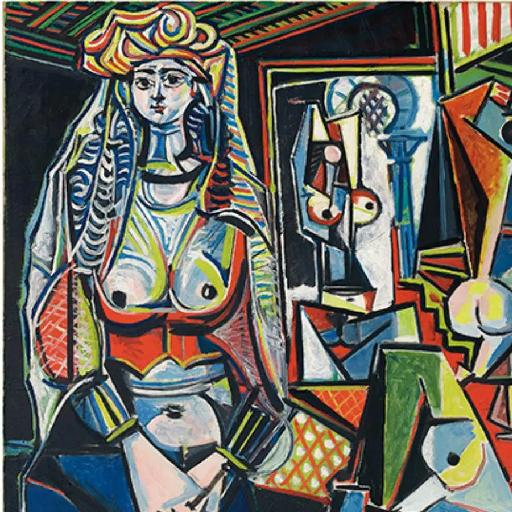

2024-10-31 17:26:03 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

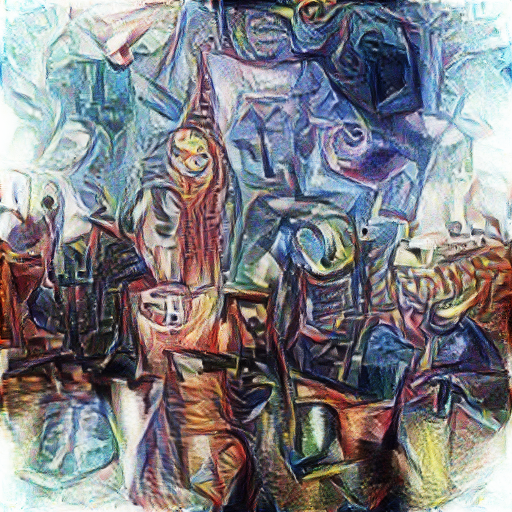
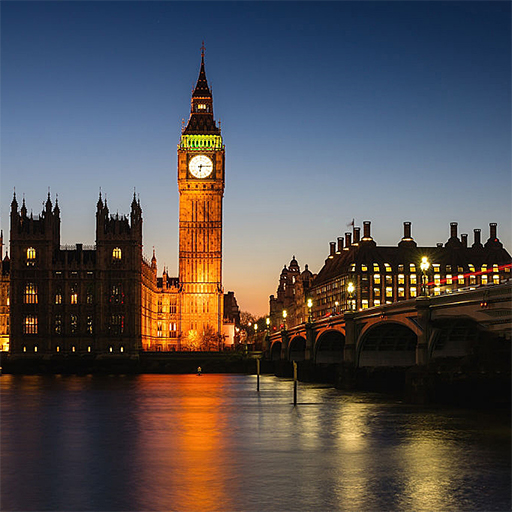
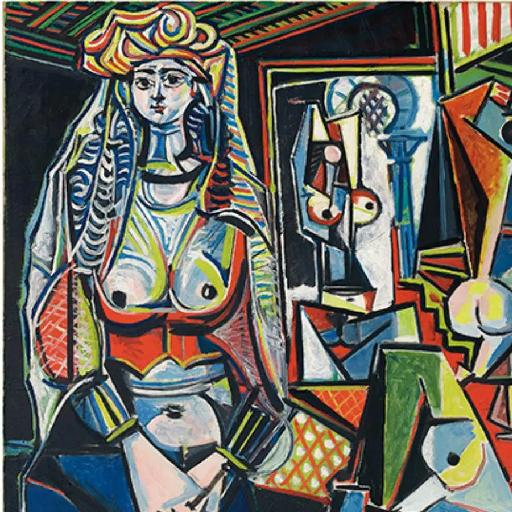

2024-10-31 17:26:03 - 30 - visionlens.img_utils.display_images_in_table:128 - INFO - Displaying 3 images in a table.


,,

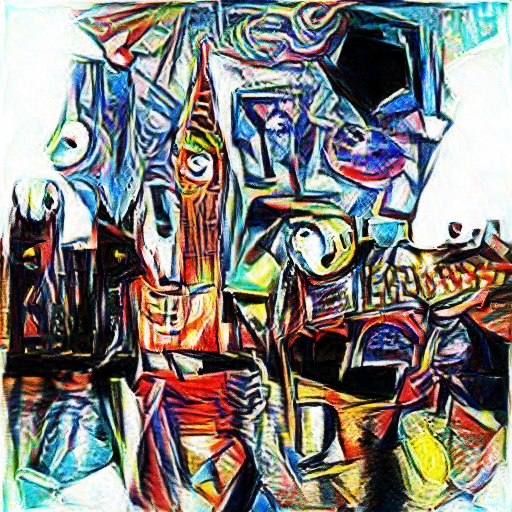
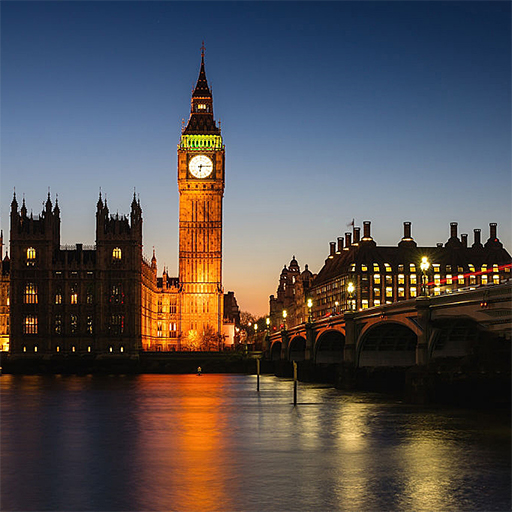
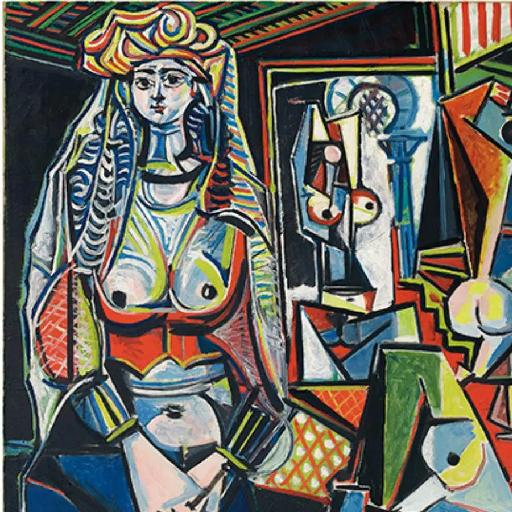

In [14]:
display_images_in_table(images[0])
display_images_in_table(images[1])
display_images_in_table(images[2])